In [7]:
import os
import sys
from tqdm import tqdm

import h5py
import yaml
import torch
import random
import numpy as np
from ema_pytorch import EMA
import matplotlib.pyplot as plt
from denoising_diffusion_pytorch import Unet

sys.path.append('../../tta_uia_segmentation/src/')

from models import ConditionalGaussianDiffusion


# Load the data

In [8]:
ds_fp = '/scratch_net/biwidl319/jbermeo/logs/brain/preprocessing/hcp_t1/data_T1_2d_size_256_256_depth_256_res_0.7_0.7_from_0_to_20.hdf_normalized_with_nn.h5'
ds_h5 = h5py.File(ds_fp, 'r')

img_size = 256
n_classes = 15
vol_idx = random.randint(0, int(ds_h5['images'].shape[0]/img_size))
slice_idx = random.randint(int(0.2 * img_size), int(0.8 * img_size))
rand_img = ds_h5['images'][vol_idx * img_size + slice_idx, :, :]
seg = ds_h5['labels'][vol_idx * img_size + slice_idx, :, :]
seg = seg 

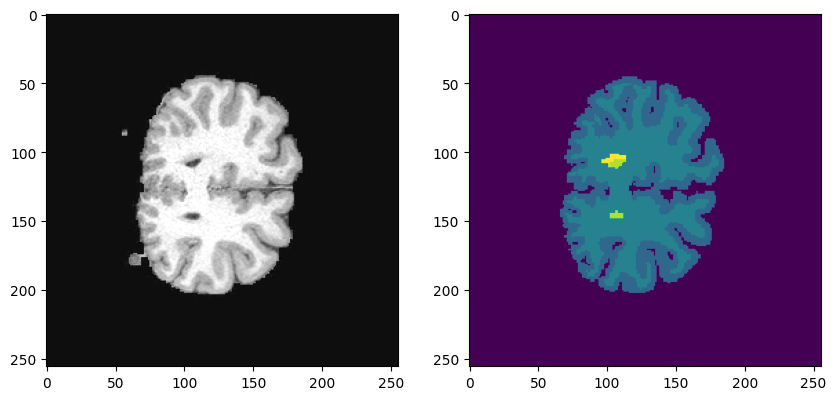

In [9]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(rand_img, cmap='gray')
ax[1].imshow(seg, cmap='viridis')
plt.show()

# Check how the noise sampling looks like

In [10]:
denoise_model = Unet(
    dim = 16,
    dim_mults = (1, 2),   
    flash_attn = True,
    channels= 1, 
    self_condition=True,
)#.to(device)

ddpm = ConditionalGaussianDiffusion(
    denoise_model,
    image_size=img_size
)

/itet-stor/jbermeo/net_scratch/conda_envs/ddpm/lib/python3.10/site-packages/torch/cuda/__init__.py:138: UserWarning: CUDA initialization: The NVIDIA driver on your system is too old (found version 10010). Please update your GPU driver by downloading and installing a new version from the URL: http://www.nvidia.com/Download/index.aspx Alternatively, go to: https://pytorch.org to install a PyTorch version that has been compiled with your version of the CUDA driver. (Triggered internally at /opt/conda/conda-bld/pytorch_1695392020201/work/c10/cuda/CUDAFunctions.cpp:108.)
  return torch._C._cuda_getDeviceCount() > 0


In [11]:
t = 150
t = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(rand_img, t, noise)

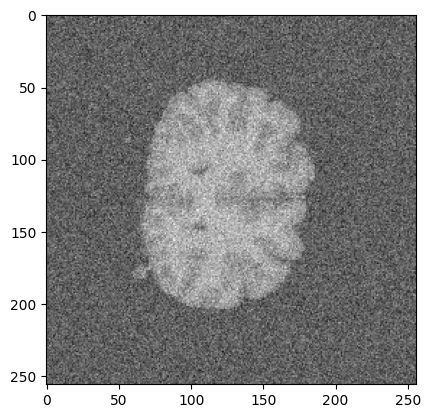

In [12]:
plt.imshow(noised_img.squeeze().detach().numpy(), cmap='gray')

# Behaviour in a trained model

### Load the checkpointed model

In [13]:
run_params = yaml.safe_load(
    open('/scratch_net/biwidl319/jbermeo/logs/brain/cddpm/params.yaml', 'r'))
cpt_path = '/scratch_net/biwidl319/jbermeo/logs/brain/cddpm/model-64.pt'

In [14]:
train_config = run_params['training']['ddpm']

timesteps           = train_config['timesteps']
sampling_timesteps  = train_config['sampling_timesteps']

# Model definition
model = Unet(
    dim = 64,
    dim_mults = (1, 2, 4, 8),   
    flash_attn = True,
    channels=1, 
    self_condition=True,
)#.to(device)

ddpm = ConditionalGaussianDiffusion(
    model,
    image_size = 256,
    timesteps = timesteps,    # Range of steps in diffusion process
    sampling_timesteps = sampling_timesteps 
)

In [15]:
cpt = torch.load(cpt_path, map_location='cpu')

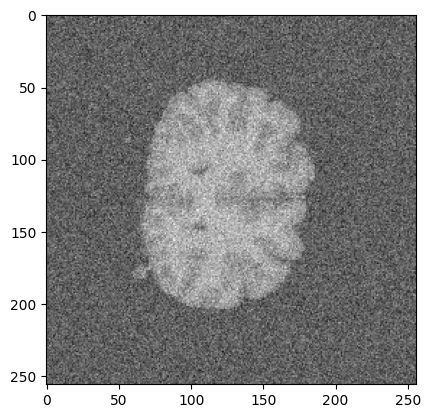

In [16]:
ema_update_every = 10
ema_decay = 0.995
ddpm_ema = EMA(ddpm, beta = ema_decay, update_every = ema_update_every)
ddpm_ema.load_state_dict(cpt['ema'])
plt.imshow(noised_img.squeeze().detach().numpy(), cmap='gray')

## How does the denoising inference function look like

In [43]:
def plot_denoising_progress(img_gt, seg_gt, img_w_noise, img_denoised_sampled, img_denoised, noise_T, t_i):
    fig, ax = plt.subplots(1, 5, figsize=(20, 5))
    ax[0].imshow(img_gt.squeeze().numpy(), cmap='gray')
    ax[0].set_title('Original')

    ax[1].imshow(seg_gt.squeeze().numpy(), cmap='viridis')
    ax[1].set_title('Segmentation GT')

    ax[2].imshow(img_w_noise.squeeze().numpy(), cmap='gray')
    ax[2].set_title(f'Noised T={noise_T}')

    ax[3].imshow(img_denoised_sampled.squeeze().numpy(), cmap='gray')
    ax[3].set_title(f'Denoised - sampled t={t_i}')

    ax[4].imshow(img_denoised.squeeze().numpy(), cmap='gray')
    ax[4].set_title(f'Denoised t={t_i}')
    
    plt.show()
    

sampling loop time step:  12%|█▏        | 49/400 [00:42<05:02,  1.16it/s]

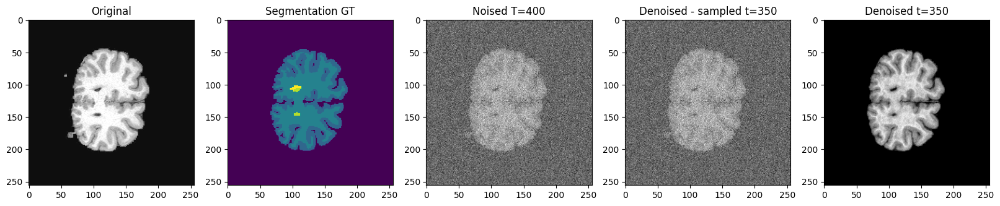

sampling loop time step:  25%|██▍       | 99/400 [01:26<03:52,  1.29it/s]

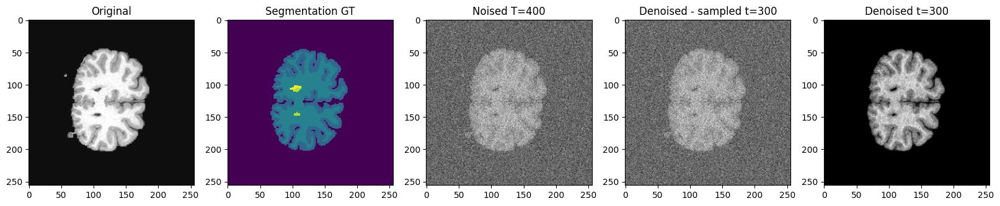

sampling loop time step:  37%|███▋      | 149/400 [02:08<03:27,  1.21it/s]

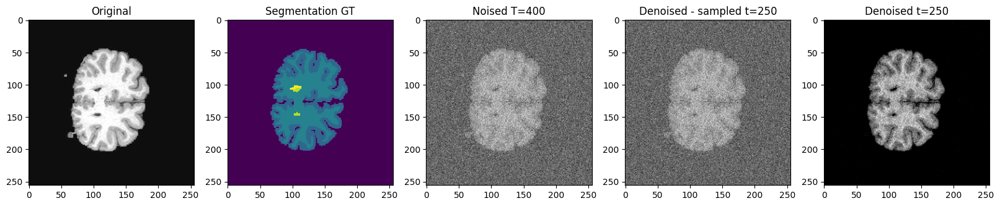

sampling loop time step:  50%|████▉     | 199/400 [02:52<02:31,  1.33it/s]

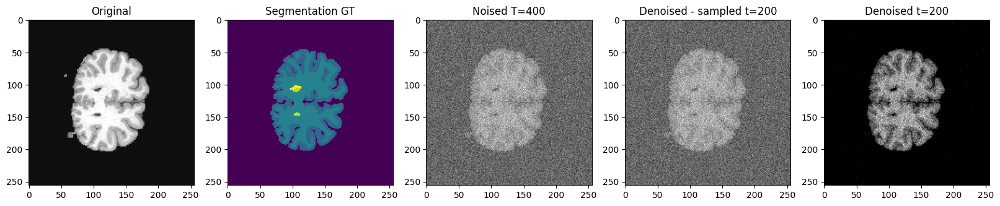

sampling loop time step:  62%|██████▏   | 249/400 [03:35<02:33,  1.01s/it]

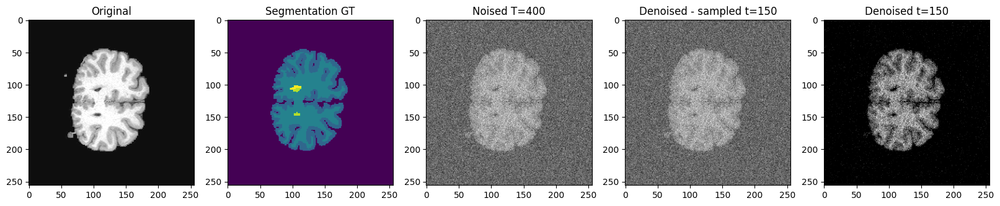

sampling loop time step:  75%|███████▍  | 299/400 [04:21<02:03,  1.22s/it]

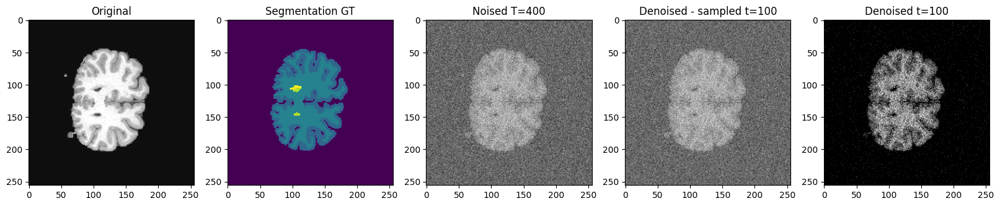

sampling loop time step:  87%|████████▋ | 349/400 [05:13<00:45,  1.11it/s]

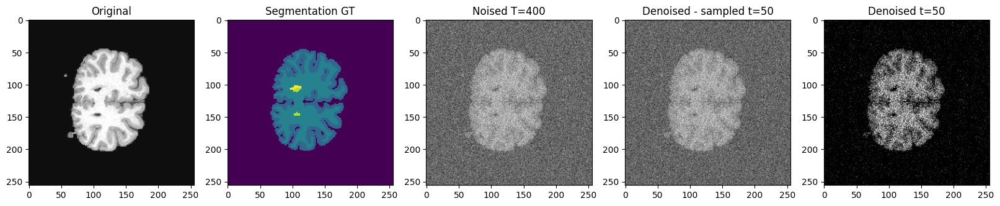

sampling loop time step: 100%|█████████▉| 399/400 [05:59<00:00,  1.13it/s]

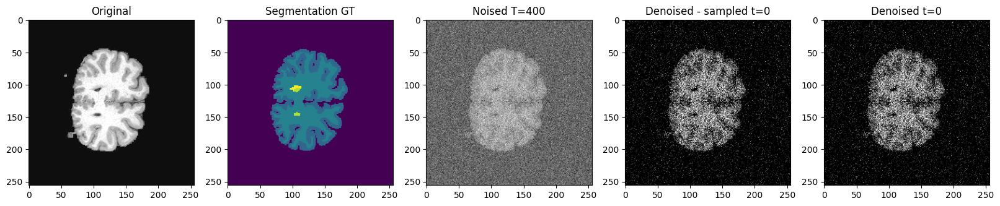

sampling loop time step: 100%|██████████| 400/400 [06:00<00:00,  1.11it/s]


In [44]:
t = 400
plot_every = 50

t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
img = ddpm_ema.model.normalize(img)
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(img, t_tch, noise)

x_cond = torch.from_numpy(seg).unsqueeze(0).unsqueeze(0).float()
x_cond = x_cond / (n_classes - 1)
x_cond = ddpm_ema.model.normalize(x_cond)


img_denoised = noised_img
for t_i in tqdm(reversed(range(0, t)), desc = 'sampling loop time step', total = t):
    img_denoised_at_ti, img_denoised_at_t0 = ddpm_ema.model.p_sample(img_denoised, t_i, x_cond)
    
    if t_i % plot_every == 0 or t_i == 0:
        plot_denoising_progress(img, x_cond, noised_img, img_denoised_at_ti, img_denoised_at_t0, t, t_i)

## How does slight noising and denoising look like

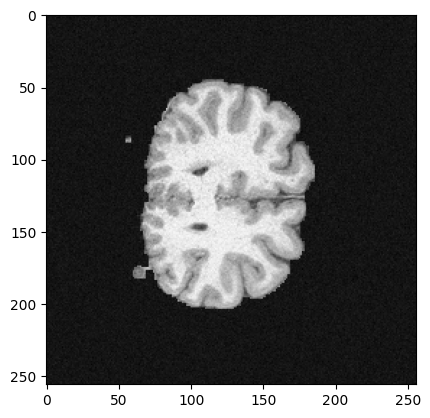

In [32]:
t = 50
t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
img = ddpm_ema.model.normalize(img)
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(img, t_tch, noise)
plt.imshow(noised_img.squeeze().detach().numpy(), cmap='gray')

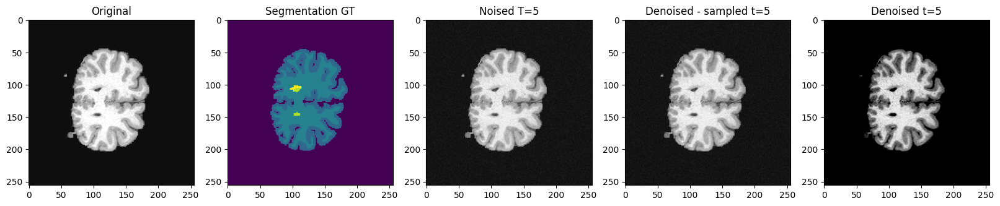

In [36]:
x_cond = torch.from_numpy(seg).unsqueeze(0).unsqueeze(0).float()
x_cond = x_cond / (n_classes - 1)
x_cond = ddpm_ema.model.normalize(x_cond)
img_denoised, v_est = ddpm_ema.model.p_sample(noised_img, t, x_cond)
plot_denoising_progress(img, x_cond, noised_img, img_denoised, v_est, t, t)

sampling loop time step:   0%|          | 0/50 [00:00<?, ?it/s]

sampling loop time step:  48%|████▊     | 24/50 [00:21<00:23,  1.10it/s]

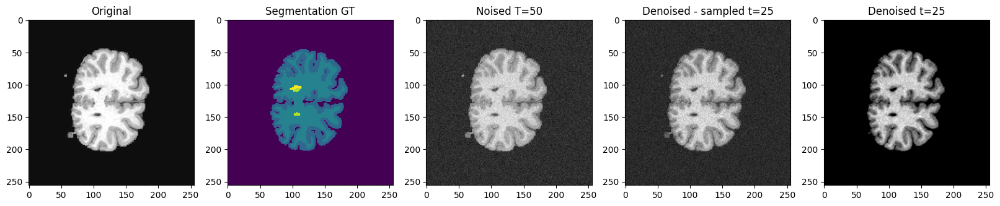

sampling loop time step:  98%|█████████▊| 49/50 [00:42<00:00,  1.08it/s]

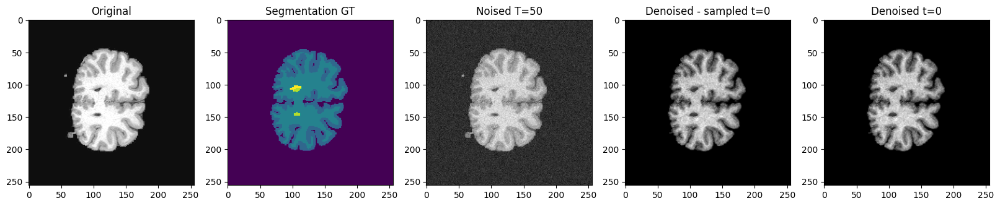

sampling loop time step: 100%|██████████| 50/50 [00:44<00:00,  1.13it/s]


In [37]:
t = 50
plot_every = 25

t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
img = ddpm_ema.model.normalize(img)
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(img, t_tch, noise)

img_denoised = noised_img

for t_i in tqdm(reversed(range(0, t)), desc = 'sampling loop time step', total = t):
    img_denoised, v_est = ddpm_ema.model.p_sample(img_denoised, t_i, x_cond)
    
    if t_i % plot_every == 0 or t_i == 0:
        plot_denoising_progress(img, x_cond, noised_img, img_denoised, v_est, t, t_i)

### Let's try with a medium ammount of noise

sampling loop time step:   0%|          | 0/200 [00:00<?, ?it/s]

sampling loop time step:  12%|█▏        | 24/200 [00:21<02:33,  1.15it/s]

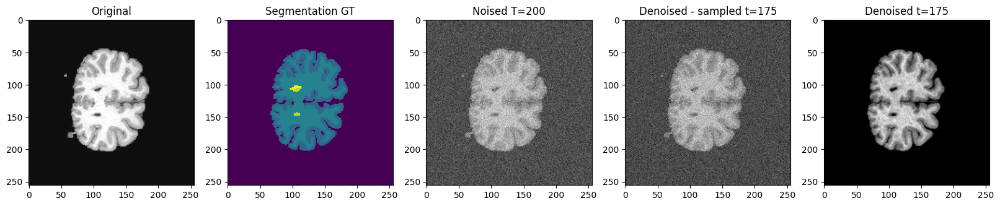

sampling loop time step:  24%|██▍       | 49/200 [00:43<01:58,  1.27it/s]

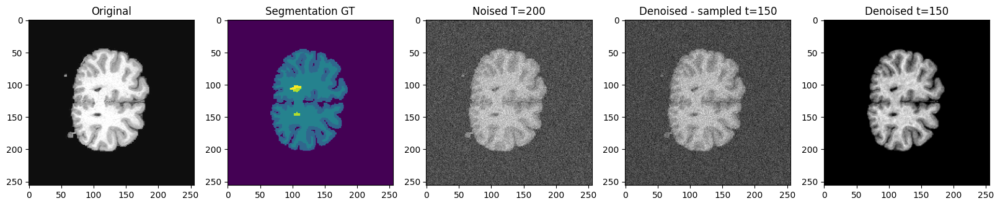

sampling loop time step:  37%|███▋      | 74/200 [01:06<02:03,  1.02it/s]

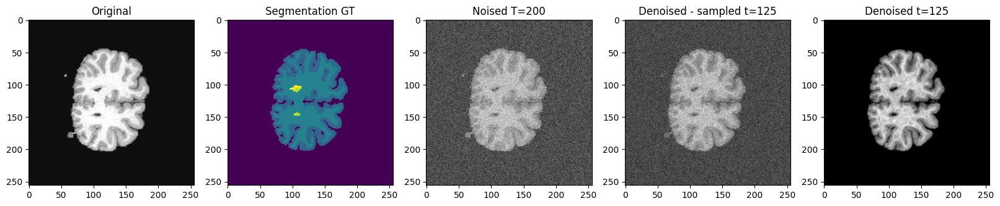

sampling loop time step:  50%|████▉     | 99/200 [01:28<01:23,  1.22it/s]

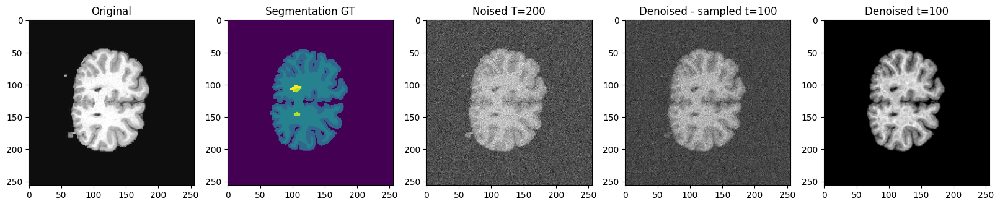

sampling loop time step:  62%|██████▏   | 124/200 [01:53<01:32,  1.21s/it]

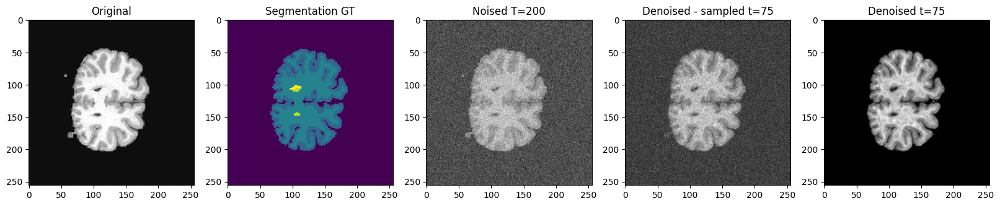

sampling loop time step:  74%|███████▍  | 149/200 [02:16<00:44,  1.15it/s]

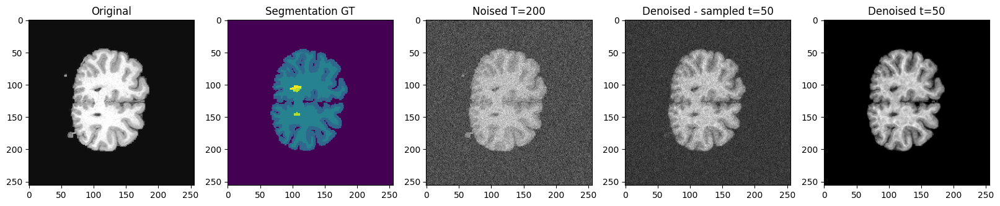

sampling loop time step:  87%|████████▋ | 174/200 [02:37<00:19,  1.30it/s]

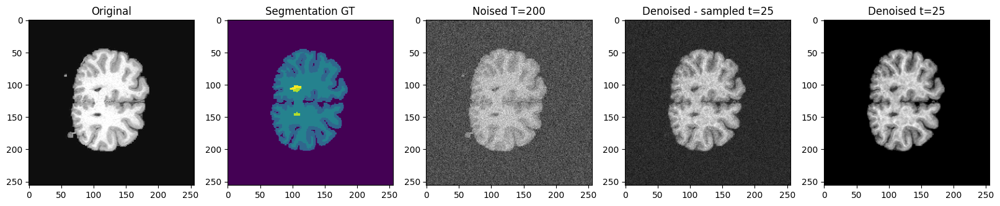

sampling loop time step: 100%|█████████▉| 199/200 [03:00<00:00,  1.31it/s]

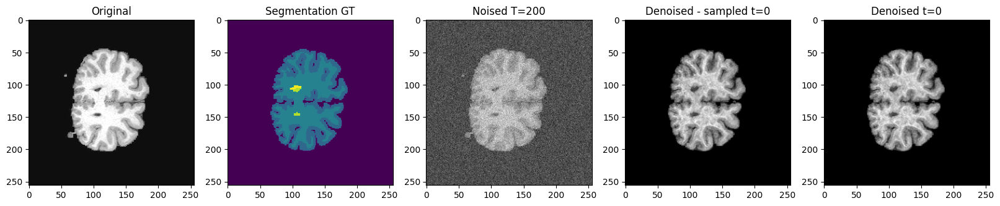

sampling loop time step: 100%|██████████| 200/200 [03:01<00:00,  1.10it/s]


In [39]:
t = 200
plot_every = 25

t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
img = ddpm_ema.model.normalize(img)
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(img, t_tch, noise)

x_cond = torch.from_numpy(seg).unsqueeze(0).unsqueeze(0).float()
x_cond = x_cond / (n_classes - 1)
x_cond = ddpm_ema.model.normalize(x_cond)


img_denoised = noised_img
for t_i in tqdm(reversed(range(0, t)), desc = 'sampling loop time step', total = t):
    img_denoised_at_ti, img_denoised_at_t0 = ddpm_ema.model.p_sample(img_denoised, t_i, x_cond)
    
    if t_i % plot_every == 0 or t_i == 0:
        plot_denoising_progress(img, x_cond, noised_img, img_denoised_at_ti, img_denoised_at_t0, t, t_i)

### Let's try with a stronger noise

sampling loop time step:   0%|          | 2/500 [00:01<07:02,  1.18it/s]

sampling loop time step:   5%|▍         | 24/500 [00:21<06:23,  1.24it/s]

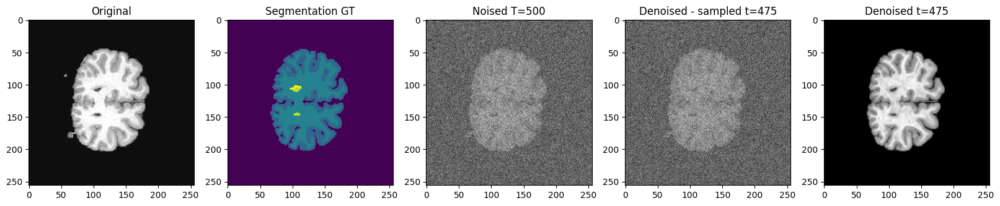

sampling loop time step:  10%|▉         | 49/500 [00:45<07:19,  1.03it/s]

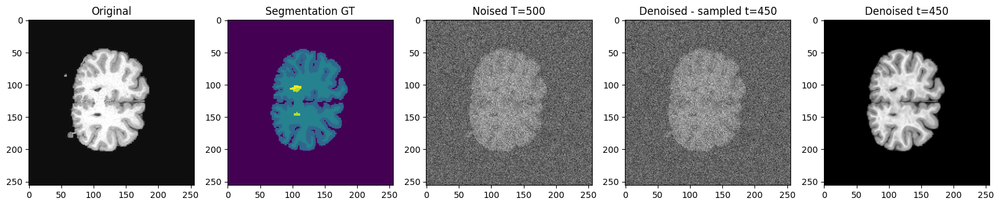

sampling loop time step:  15%|█▍        | 74/500 [01:07<05:38,  1.26it/s]

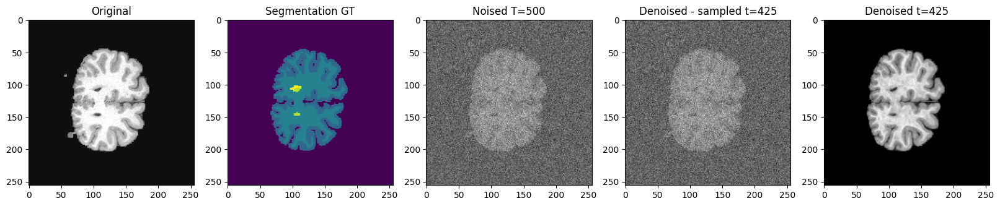

sampling loop time step:  20%|█▉        | 99/500 [01:31<07:31,  1.13s/it]

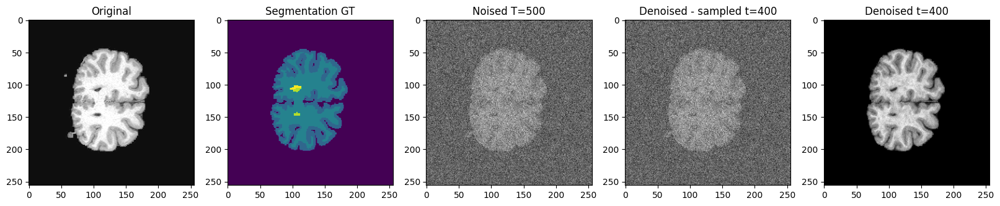

sampling loop time step:  25%|██▍       | 124/500 [01:55<05:55,  1.06it/s]

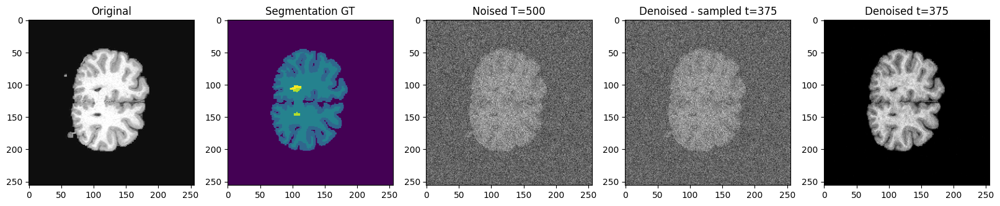

sampling loop time step:  30%|██▉       | 149/500 [02:16<04:24,  1.33it/s]

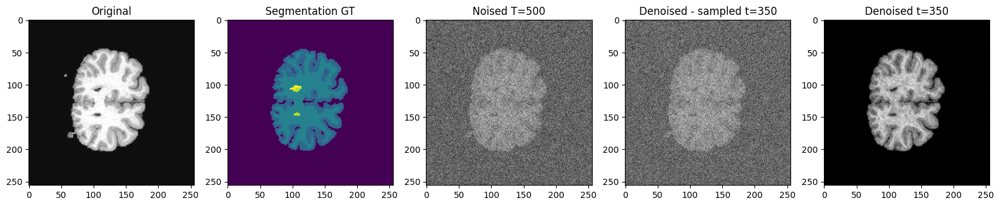

sampling loop time step:  35%|███▍      | 174/500 [02:39<05:41,  1.05s/it]

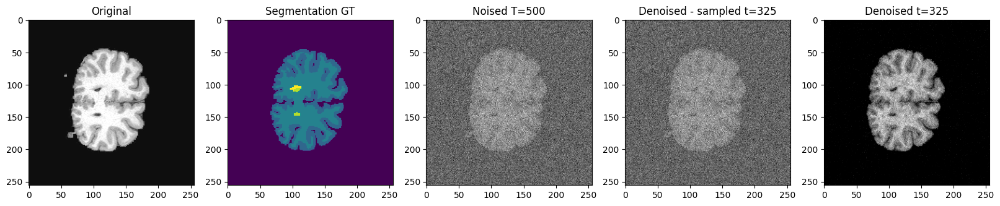

sampling loop time step:  40%|███▉      | 199/500 [03:02<04:19,  1.16it/s]

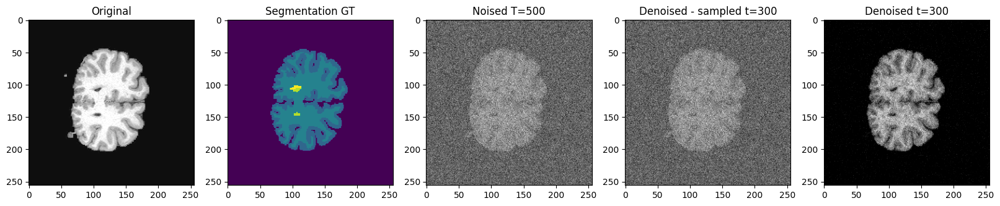

sampling loop time step:  45%|████▍     | 224/500 [03:24<03:47,  1.21it/s]

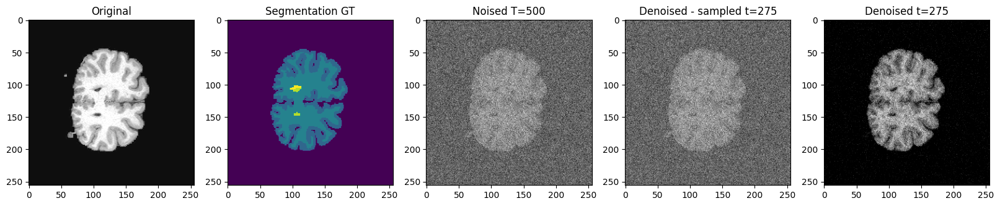

sampling loop time step:  50%|████▉     | 249/500 [03:46<03:11,  1.31it/s]

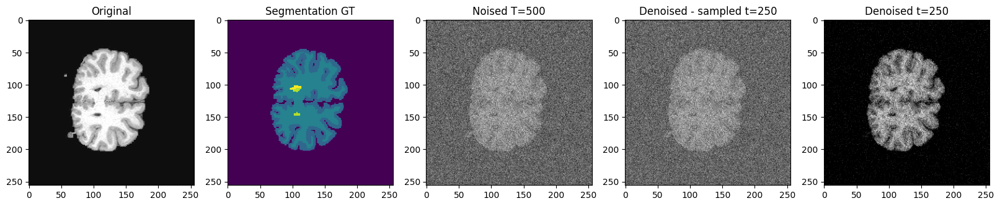

sampling loop time step:  55%|█████▍    | 274/500 [04:08<03:16,  1.15it/s]

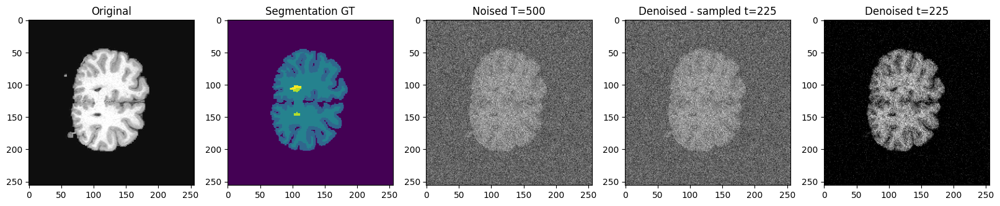

sampling loop time step:  60%|█████▉    | 299/500 [04:30<02:59,  1.12it/s]

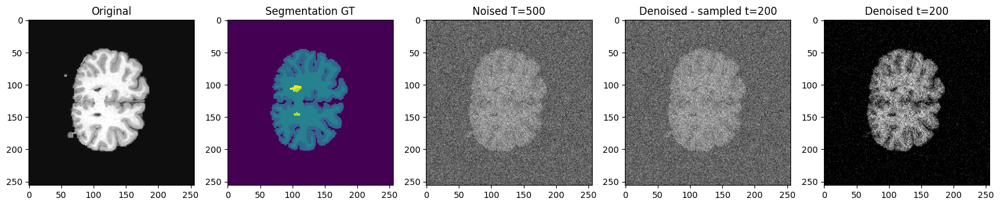

sampling loop time step:  65%|██████▍   | 324/500 [04:53<02:43,  1.07it/s]

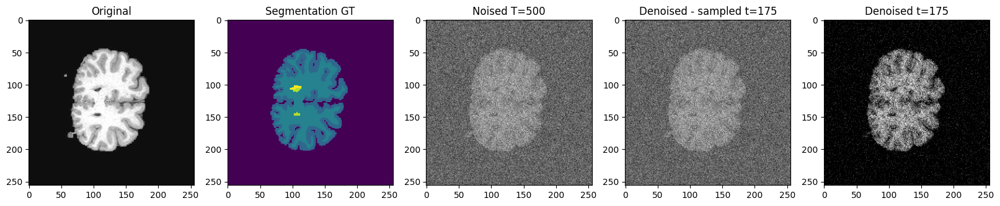

sampling loop time step:  70%|██████▉   | 349/500 [05:15<02:15,  1.12it/s]

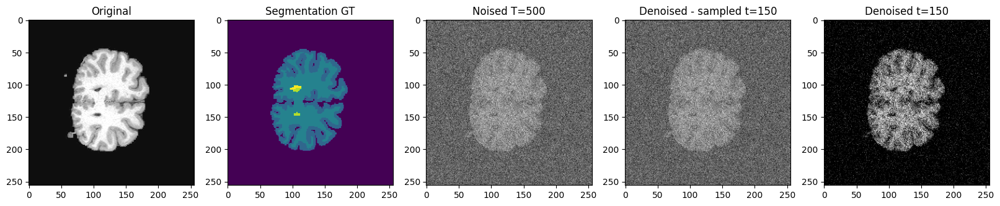

sampling loop time step:  75%|███████▍  | 374/500 [05:35<01:48,  1.16it/s]

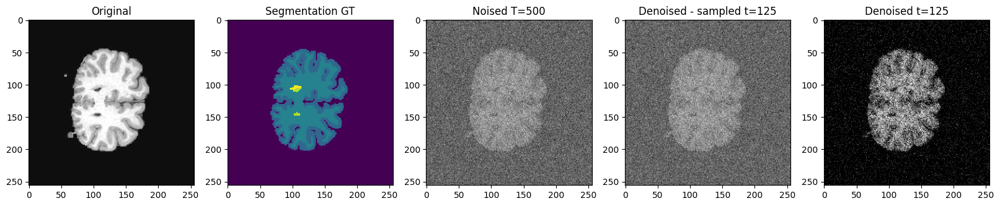

sampling loop time step:  80%|███████▉  | 399/500 [05:58<01:34,  1.06it/s]

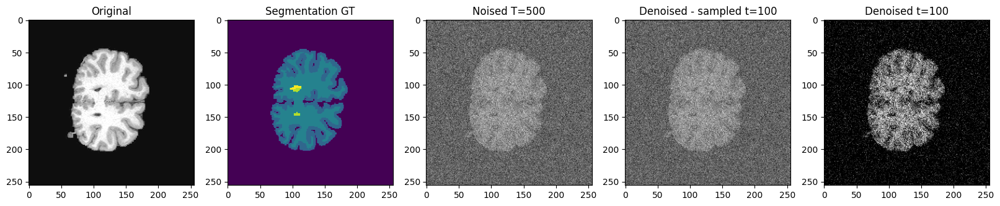

sampling loop time step:  85%|████████▍ | 424/500 [06:20<01:07,  1.13it/s]

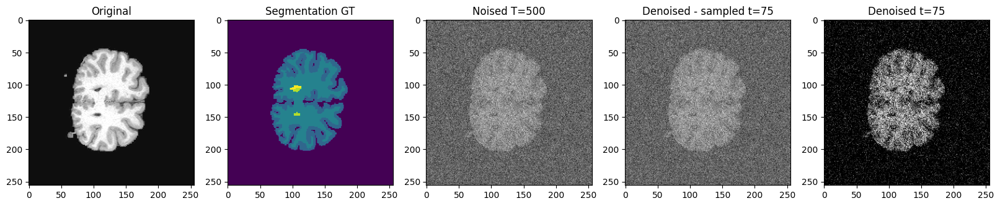

sampling loop time step:  90%|████████▉ | 449/500 [06:41<00:39,  1.29it/s]

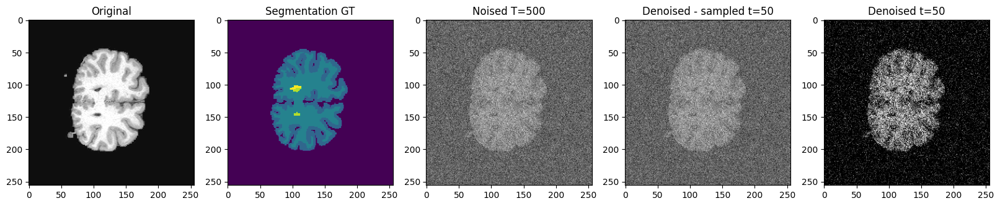

sampling loop time step:  95%|█████████▍| 474/500 [07:03<00:22,  1.17it/s]

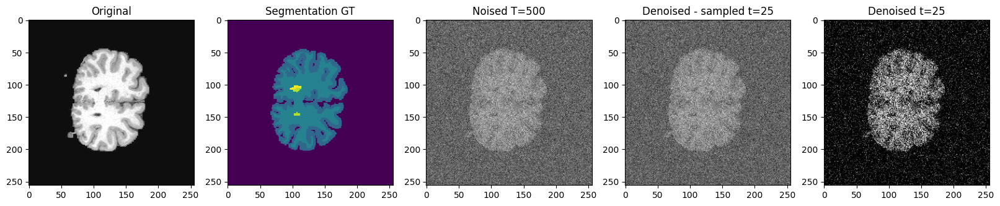

sampling loop time step: 100%|█████████▉| 499/500 [07:25<00:00,  1.31it/s]

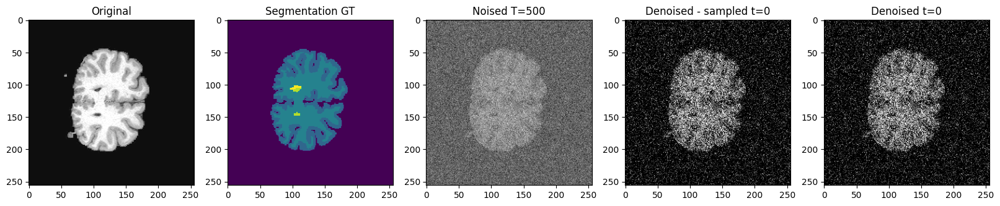

sampling loop time step: 100%|██████████| 500/500 [07:27<00:00,  1.12it/s]


In [40]:
t = 500
plot_every = 50

t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
img = ddpm_ema.model.normalize(img)
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(img, t_tch, noise)

x_cond = torch.from_numpy(seg).unsqueeze(0).unsqueeze(0).float()
x_cond = x_cond / (n_classes - 1)
x_cond = ddpm_ema.model.normalize(x_cond)


img_denoised = noised_img
for t_i in tqdm(reversed(range(0, t)), desc = 'sampling loop time step', total = t):
    img_denoised_at_ti, img_denoised_at_t0 = ddpm_ema.model.p_sample(img_denoised, t_i, x_cond)
    
    if t_i % plot_every == 0 or t_i == 0:
        plot_denoising_progress(img, x_cond, noised_img, img_denoised_at_ti, img_denoised_at_t0, t, t_i)

sampling loop time step:   6%|▌         | 49/800 [00:40<10:22,  1.21it/s]

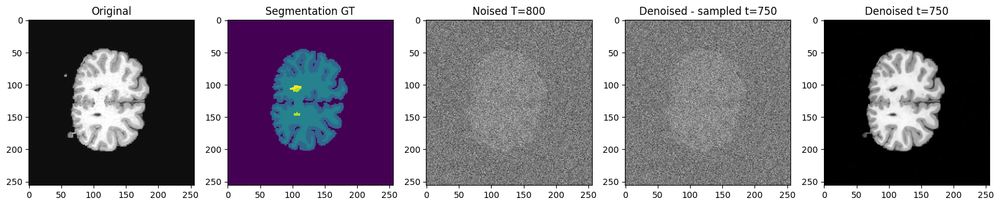

sampling loop time step:  12%|█▏        | 99/800 [01:25<11:23,  1.03it/s]

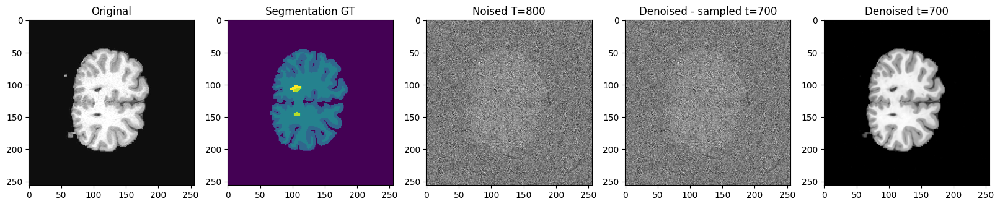

sampling loop time step:  19%|█▊        | 149/800 [02:08<08:42,  1.25it/s]

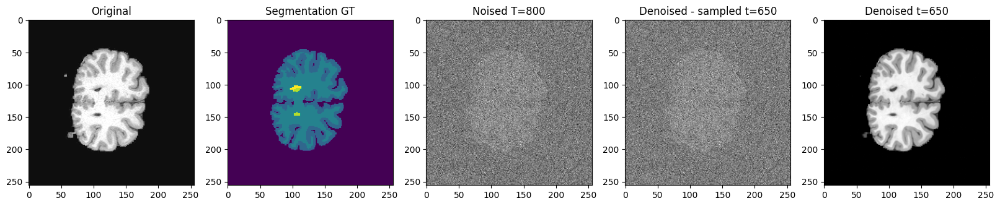

sampling loop time step:  25%|██▍       | 199/800 [02:52<09:30,  1.05it/s]

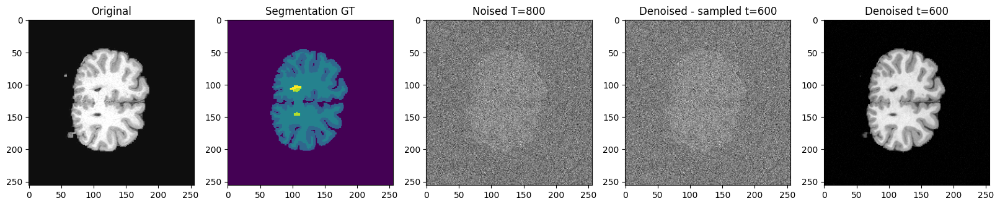

sampling loop time step:  31%|███       | 249/800 [03:34<07:18,  1.26it/s]

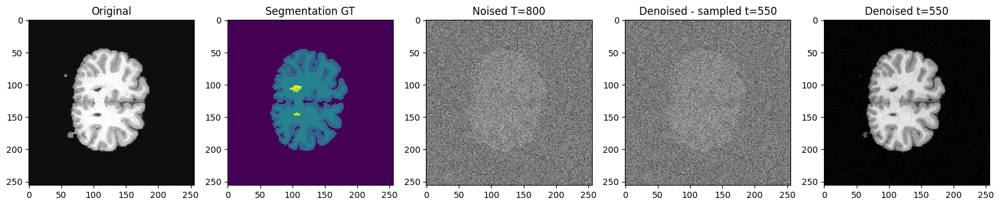

sampling loop time step:  37%|███▋      | 299/800 [04:22<08:25,  1.01s/it]

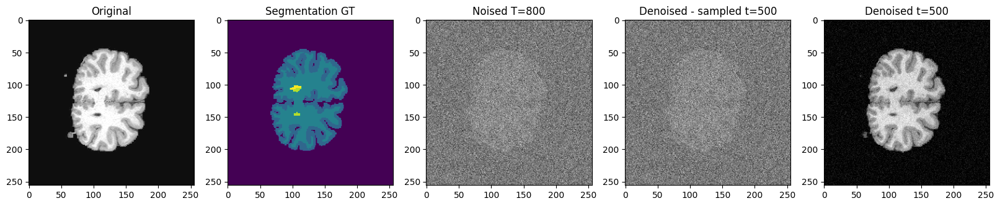

sampling loop time step:  44%|████▎     | 349/800 [05:17<07:33,  1.01s/it]

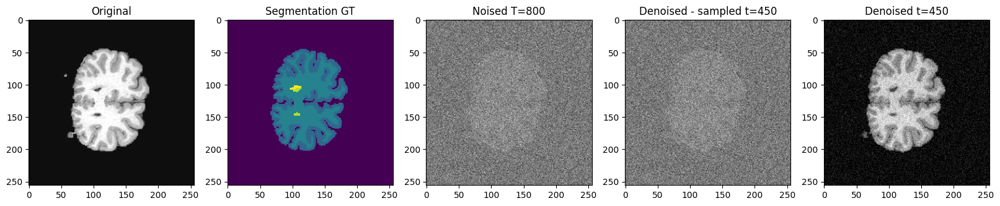

sampling loop time step:  50%|████▉     | 399/800 [06:14<06:58,  1.04s/it]

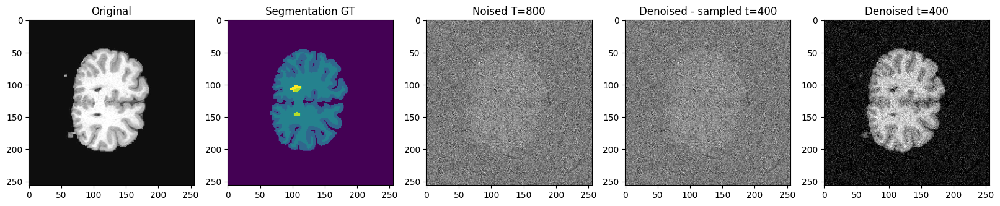

sampling loop time step:  56%|█████▌    | 449/800 [07:07<06:35,  1.13s/it]

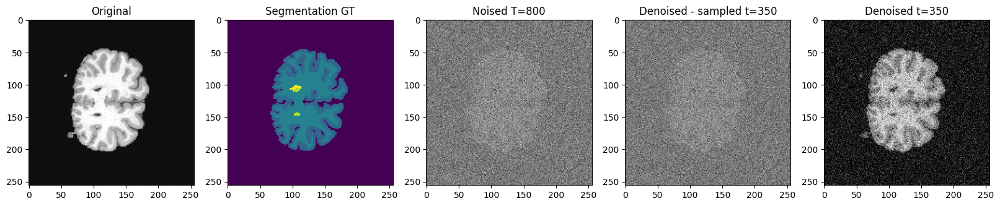

sampling loop time step:  62%|██████▏   | 499/800 [08:03<05:51,  1.17s/it]

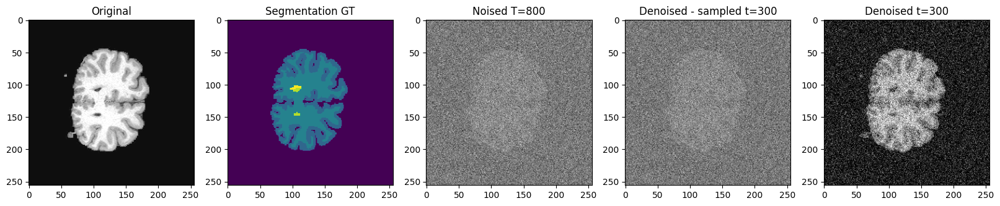

sampling loop time step:  69%|██████▊   | 549/800 [08:58<04:40,  1.12s/it]

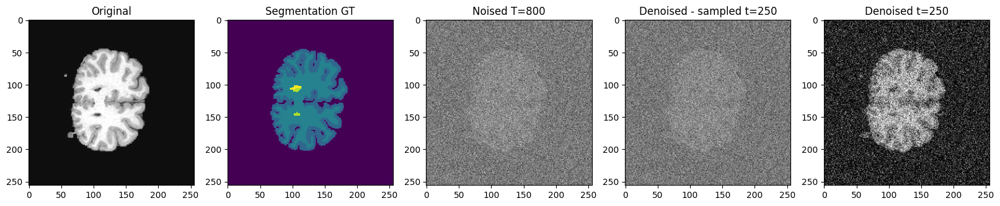

sampling loop time step:  75%|███████▍  | 599/800 [09:52<03:39,  1.09s/it]

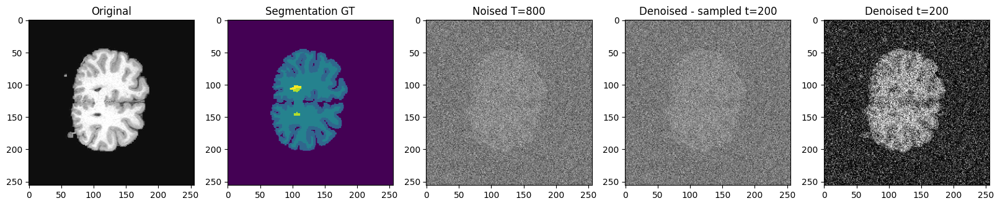

sampling loop time step:  81%|████████  | 649/800 [10:48<02:55,  1.16s/it]

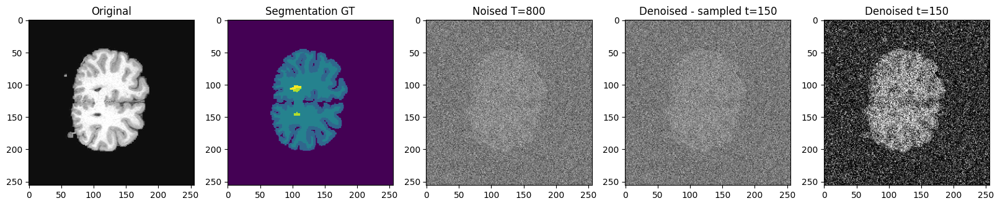

sampling loop time step:  87%|████████▋ | 699/800 [11:44<01:58,  1.17s/it]

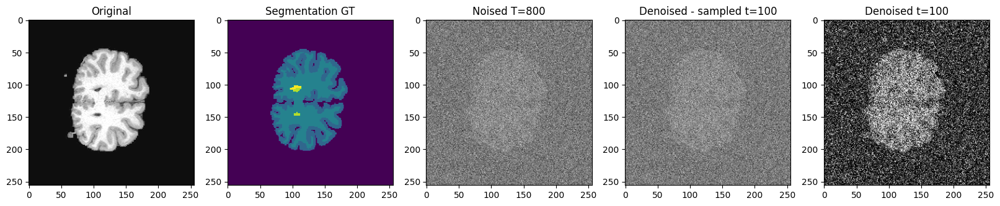

sampling loop time step:  94%|█████████▎| 749/800 [12:25<00:46,  1.09it/s]

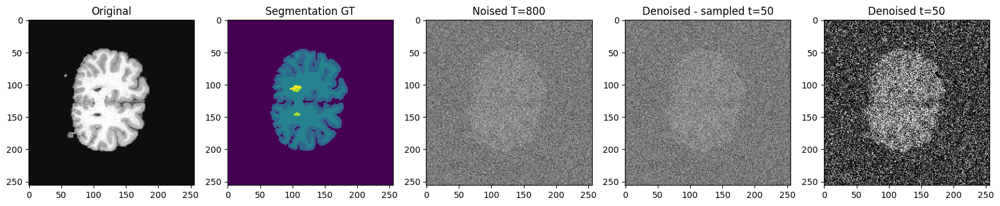

sampling loop time step: 100%|█████████▉| 799/800 [13:07<00:01,  1.00s/it]

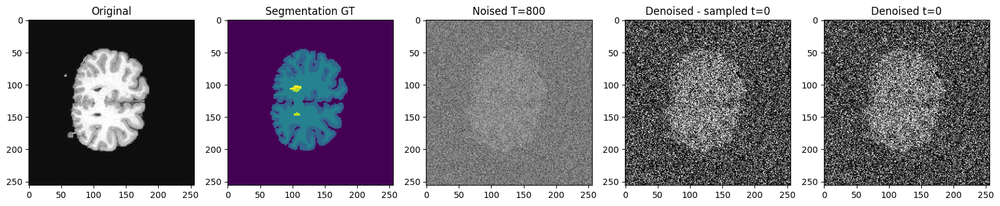

sampling loop time step: 100%|██████████| 800/800 [13:09<00:00,  1.01it/s]


In [42]:
t = 800
plot_every = 50

t_tch = torch.full((1,), t)
img = torch.from_numpy(rand_img).unsqueeze(0).unsqueeze(0).float()
img = ddpm_ema.model.normalize(img)
noise = torch.randn_like(img)

noised_img = ddpm.q_sample(img, t_tch, noise)

x_cond = torch.from_numpy(seg).unsqueeze(0).unsqueeze(0).float()
x_cond = x_cond / (n_classes - 1)
x_cond = ddpm_ema.model.normalize(x_cond)


img_denoised = noised_img
for t_i in tqdm(reversed(range(0, t)), desc = 'sampling loop time step', total = t):
    img_denoised_at_ti, img_denoised_at_t0 = ddpm_ema.model.p_sample(img_denoised, t_i, x_cond)
    
    if t_i % plot_every == 0 or t_i == 0:
        plot_denoising_progress(img, x_cond, noised_img, img_denoised_at_ti, img_denoised_at_t0, t, t_i)

## How does DDIM sampling behave?

### When used on smaller noising levels